# **Enhancing Epidemic Modeling: A Dynamic Agent-Based Framework for Realistic Transmission Simulation**

Runtime: 5 minutes 30 seconds (excluding appendix)

In [187]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In the recent pandemic, we witnessed the ability of technology to monitor and forecast the spread of disease. Disease modelling is crucial to our understanding of infectious diseases. A well-structured, literature-backed model can guide government policies and support public health responses to curb disease spread.

Common disease modelling methods include "compartmental" and "agent-based" models. Compartmental models divide the population into "susceptible", "infected", and "recovered" groups and use simple differential equations to predict the progression of disease spread, while agent-based models are more flexible, capturing diverse individual conditions present in a heterogenous population, and enable the simulation of public health measures and their effects on disease spread.

# **Agent-based Modelling**

We will take an "agent-based" approach to simulate the spread of a virus within a city instead of directly using the SIR model for calculations. "Person"s (`class Person` objects) will be created to move on a grid (`class Grid` objects) from place to place (`class CBG` and `class POI` objects). With this model, we get more flexibility to alter their behaviour and observe how the infection pattern of the disease changes accordingly.

## Creating Humans - `class Person`

The `Person` class is the foundation for this model. A `Person` instance has a few defined variables, such as their `recovery_time` (amount of time to recover from an infection), `latency_time` (infection latency time) and `infection_chance` (chance of infection after coming into contact with infected individuals).

A `Person` also has various mutable attributes, including their `position`, `velocity`, `susceptible`(boolean), `infection_timer` (counts down the time required for recovery), and `latency_timer` (counts down the time required for a person to start transmitting the pathogen after being infected).

We will be using these simplified Persons to simulate the transmission of an infectious disease in an urban city setting.

In [198]:
class Person:

    def __init__(
        self, speed=None, location=None, velocity=np.array([0, 0]),
        idle_time=None, idle_timer=0,
        home=None, at=None, destination=None,
        infection_chance=None, susceptible=True,
        recovery_time=None, latency_time=None,
        infection_timer=0, latency_timer=0,
        ):

        # attributes of Person
        self.speed = speed                          # basic movement speed of the Person

        self.location = location                    # current coordinate of person (x, y) (nparray)
        self.velocity = velocity                    # current velocity of person (nparray)

        self.idle_time = idle_time                  # idle time of person (int)
        self.idle_timer = idle_timer                # the person will be idle for this amount of time (int)
                                                    # when below zero, acts as a movement duration timer
                                                    # (the person will continue moving for the next [-n] time units)
        self.home = home                            # home object (CBG) of the Person
        self.at = at                                # location of the Person
        self.destination = destination              # destination of the Person

        self.infection_chance = infection_chance    # probability of infection within infection_radius of another person
        self.susceptible = susceptible              # whether or not the person is susceptible to infection (bool)
        self.recovery_time = recovery_time          # time required to recover ()
        self.latency_time = latency_time            # length of the latency period
        self.infection_timer = infection_timer      # timer for infection, becomes recovered when timer hits 0 (int)
        self.latency_timer = latency_timer          # timer for latency period, Person becomes infectious when timer hits 0 (int)

        self.infected_persons = 0                   # number of persons infected by this person

    # Get x coordinate of the Person
    def get_x(self):
        return self.location[0]


    # Get y coordinate of the Person
    def get_y(self):
        return self.location[1]


    # Get x coordinate of the Person
    def get_v_x(self):
        return self.velocity[0]


    # Get y coordinate of the Person
    def get_v_y(self):
        return self.velocity[1]


## Creating Regions (on a Grid) - `class CBG` and `class POI`

Circular **census block group**, aka **"CBG"** (residence district) and **point of interest**, aka **"POI"** (business/educational/recreational/healthcare district) will be created on the grid to mimic regions with different properties. Regions will be stored using a "centre coordinate" and a "radius" value.

We define census block group (CBG) objects to represent residential areas,

In [227]:
## Creating neighbourhood (CBGs)
class CBG:

    def __init__(
        self,
        location=None,
        radius=None
    ):
        self.location = location
        self.radius = radius

    # __str__ is for users to read, __repr__ is intended to allow recreation of identical object
    def __str__(self):
        return f"Location of the CBG: {self.location.tolist()}, \
              Radius of the CBG: {self.radius}, \
              Area of the CBG: {np.pi * (self.radius ** 2)}"    # .tolist() adds a comma in the coordinates

    def __repr__(self):
        return f"location = {self.location}, radius = {self.radius}"

and point of interest (POI) objects to represent business districts, schools, and markets, etc.



In [200]:
## Creating destination (POIs)
class POI:

    def __init__(
        self,
        location=None,
        radius=None
    ):
        self.location = location
        self.radius = radius

    def __str__(self):
        return f"Location of the POI: {self.location.tolist()}, \
                Radius of the POI: {self.radius}, \
                Area of the POI: {np.pi * (self.radius ** 2)}"

    def __repr__(self):
        return f"location = {self.location}, radius = {self.radius}"

We created `CBG` and `POI` as separate classes to allow future modifications specific to each type of place. This approach makes it easier to add different categories of POIs, like hospitals, workplaces, or schools, without affecting the functionality of CBGs. By keeping these classes separate, we can adapt or expand each type independently, ensuring flexibility and preventing unintended changes across different place types.

## Creating, Moving and Infecting People in the Simulation Grid - methods in `class Grid`

### A. Uniformly Populating a Circle - method `Grid.populate()`

We will be simulating the activity of people on a rectangular grid. Before we start, we will elaborate on how to uniformly populate a circle with a uniform random number generator. This method is used when we are populating CBGs.

To evenly distribute points inside a circle (e.g., when placing CBGs on the grid), we need to account for the area growth as we move outward from the center.

**1. Area and Radius Relationship**

The area of a circle grows with the square of its radius (Area = $\pi r^2 $). This means there’s more space in the outer rings of the circle than near the center.

If we randomly choose a radius, $r$ directly between $0$ and $R$, each value of
$r$ would be equally likely. However, this would lead to more points clustering near the center, because the inner rings (smaller $r$) cover less area than the outer rings (larger $r$).

**2. Correcting the Probability Distribution**

If we want to sample points uniformly over the entire **area** of the circle. The probability that a point lies on the ring with radius $r$ must be proportional to the area covered by the circle up to that radius. That is:

$P(r \leq R) \propto A(r) = \pi r^2$

This says the probability of picking a point within a radius $r$ is proportional to the fraction of the area up to that radius. That is:

$P(r \leq R) = \frac{A(r)}{A(R)} = \frac{r^2}{R^2}$

**3. Inverting the Quadratic Relationship**

We want to find a way to sample **random points** such that this cumulative probability distribution $P(r)$ (proportional to $r^2$) is preserved. To do this, we need to have a uniformly distributed random number $U \sim \text{Uniform}(0, 1)$, thus:

$U = \frac{r^2}{R^2}$

Rearranging for $r$:

$r = R \sqrt{U}$

Where $U$ is a random number between 0 and 1, sampled from a uniform distribution.

This adjustment ensures that $r$ follows a distribution that reflects the area growth of the circle, making the points uniformly distributed across the area.


In [201]:
# This method is included in the "Grid" class

'''
r = cbg.radius * np.sqrt(rng.uniform(0, 1))
'''

'\nr = cbg.radius * np.sqrt(rng.uniform(0, 1))\n'

### B. Moving People Between Locations - method `Grid.movement_tick()`

Attributes of Person used in this system:

```
velocity     (np.array)
destination  (POI/CBG object)
at           (POI/CBG object)
home         (POI/CBG object)
idle_timer   (float)

```

Mechanism:
```
Iterate through all persons on the list and perform the following:
1. If person is idle (idle_timer > 0)
    -> -1 from the idle_timer
2. If the person is moving towards a destination but has not reached yet (idle_timer < -1)
    -> +1 to the idle_timer
3. If the person reaches the destination (-1 <= idle_timer < 0)
    -> set velocity to zero and set idle_timer to default idle time
4. If the person reaches the end of the idle period (idle_timer == 0)
    a. If they are at home, set a random POI as the destination
    b. If not, go home
```

Here we define a function to perform one "movement tick" on every individual of a grid. A movement tick checks if a person is currently "idle", "non-idle (moving)", or "waiting for decision (when `idle_timer` reaches 0)" and performs correspoding actions on the person.

In [202]:
# This method is included in the "Grid" class

'''
def movement_tick(self):

    ## The "set_target" function is used to set a target destination (POI/CBG),
    ## and then calculate the required velocity and movement time to reach a certain target.
    ## The calculation result, including the direction and duration of their movement, will then be assigned to the "Person".
    def set_target(person, target):

        # Generate random radius
        r = target.radius * np.sqrt(np.random.rand())     # np.sqrt is required to ensure uniform distribution of the points inside a circle,
                                                          # without np.sqrt, most points would be concentrated near the center of the circle.
        # Generate random angle
        theta = np.random.uniform(0, 2 * np.pi)

        # Generate the target coordinate
        x = target.location[0] + (r * np.cos(theta))
        y = target.location[1] + (r * np.sin(theta))
        target_loc = np.array([x, y])                     # The person's target location
        target_vec = target_loc - person.location         # vector from the person to the target

        # Finding the person's velocity and travel time
        person.velocity = target_vec / np.linalg.norm(target_vec) * person.speed    # calculate velocity (includes direction and speed) per tick
        person.idle_timer = (-1) * np.linalg.norm(target_vec) / person.speed        # distance / speed = travel time, negative sign is a movement identifier

        # Setting destination
        person.destination = target

    # Tick infection and latency timers, and perform movement of a Person
    def tick(person):

        # Tick down infection and/or latency timers if their values are greater than 0
        if person.infection_timer > 0:
            person.infection_timer -= 1
        if person.latency_timer > 0:
            person.latency_timer -= 1

        # Perform movement on the plane
        person.location += person.velocity

    # Iterate through all Persons in the population, check their idle status and perform movement actions accordingly
    for person in self.population:

        if person.idle_timer > 0:                  # if idlling (-> stay still)
            person.idle_timer -= 1

        elif person.idle_timer < -1:               # if in motion (-> keep moving)
            person.idle_timer += 1

        elif -1 <= person.idle_timer < 0:          # if the tick before reaching destination
            tick(person)
            person.velocity = np.array([0, 0])     # set speed to 0
            person.idle_timer = person.idle_time   # set idle timer to Person's idle time
            person.at = person.destination         # set person to be at the destination
            continue                               # move on to tick the next Person on the list

        elif person.idle_timer == 0:               # if simulation starts or idle ends (-> find somewhere to go)
            if person.at is person.home:           # using "is" check whether the two attributes "point to" the same object.

                # hasattr check if the Person has allowed_pois attribute
                # person.allowed_pois will return True if it is not an empty list, this thus checks for empty list
                if hasattr(person, 'allowed_pois') and person.allowed_pois:
                    # Choose a POI within the allowed range if in lockdown
                    set_target(person, np.random.choice(person.allowed_pois))
                else:
                    # Otherwise, randomly select any POI (if not in lockdown)
                    set_target(person, np.random.choice(self.all_poi))

            else:
                set_target(person, person.home)

        tick(person)
'''

'\ndef movement_tick(self):\n\n    ## The "set_target" function is used to set a target destination (POI/CBG),\n    ## and then calculate the required velocity and movement time to reach a certain target.\n    ## The calculation result, including the direction and duration of their movement, will then be assigned to the "Person".\n    def set_target(person, target):\n\n        # Generate random radius\n        r = target.radius * np.sqrt(np.random.rand())     # np.sqrt is required to ensure uniform distribution of the points inside a circle,\n                                                          # without np.sqrt, most points would be concentrated near the center of the circle.\n        # Generate random angle\n        theta = np.random.uniform(0, 2 * np.pi)\n\n        # Generate the target coordinate\n        x = target.location[0] + (r * np.cos(theta))\n        y = target.location[1] + (r * np.sin(theta))\n        target_loc = np.array([x, y])                     # The person\'s 

### C. Transmission  - method `Grid.infection_tick()`

A method similar to movement_tick, but to check whether a Person is infected or not in any given tick.

In [203]:
# This method is included in the "Grid" class

'''
def infection_tick(self):

    # Function to perform infection attempt on a Person
    def infect(person):
        person.infection_timer = person.recovery_time   # start the recovery timer
        person.latency_timer = person.latency_time      # start the latency timer
        person.susceptible = False                      # set person to NOT susceptible
        return

    # Iterate through all Person pairs to check for health status (S/I/R),
    # and attempt to infect accordingly
    for pair in self.population_pairs:
        a = pair[0]
        b = pair[1]
        distance_ab = np.linalg.norm(a.location - b.location)

        if distance_ab <= self.infection_radius:
            if a.susceptible == b.susceptible:   # if both susceptible (not infected) or both NOT susceptible (both infected or recovered)
                continue                         # do nothing
            elif b.infection_timer > 0 and b.latency_timer == 0:    # if "b" is infectious
                if np.random.random() <= a.infection_chance:
                    infect(a)
            elif a.infection_timer > 0 and a.latency_timer == 0:    # if "a" is infectious
                if np.random.random() <= b.infection_chance:
                    infect(b)
'''

'\ndef infection_tick(self):\n\n    # Function to perform infection attempt on a Person\n    def infect(person):\n        if not person.susceptible:\n            return\n        else:\n            person.infection_timer = person.recovery_time   # start the recovery timer\n            person.latency_timer = person.latency_time      # start the latency timer\n            person.susceptible = False                      # set person to NOT susceptible\n            return\n\n    # Iterate through all Person pairs to check for health status (S/I/R),\n    # and attempt to infect accordingly\n    for pair in self.population_pairs:\n\n        a = pair[0]\n        b = pair[1]\n        distance_ab = np.linalg.norm(a.location - b.location)\n\n        if distance_ab <= self.infection_radius:\n            if a.susceptible == b.susceptible:   # if both susceptible (not infected) or both NOT susceptible (both infected or recovered)\n                continue                         # do nothing\n      

## Creating, Running and Visualising the Simulation Grid - `class Grid`

Code Implementation

In [204]:
class Grid:

    def __init__(self, x_length=None, y_length=None, population_size=None,
                 cbg_count=None, cbg_min_radius=None, cbg_max_radius=None,
                 poi_count=None, poi_min_radius=None, poi_max_radius=None,
                 idle_time=None,            # default idle time after a person reaches a destination
                 default_movement_speed=None,  # default movement speed of persons
                 infection_radius=None,      # radius of the infectious zone around a person
                 infection_chance=None,     # default infection chance for all Persons on this Grid (float)
                 recovery_time=None,        # default recovery period for all Persons on this Grid (int)
                 latency_time=None,         # default latency period for all Persons on this Grid (int)
                 title=None,                # title of plot
                 seed=None):

        self.x_max = x_length     # setting the boundaries of x
        self.y_max = y_length     # setting the boundaries of y
        self.population_size = population_size
        self.population = []         # a list to store all the Persons on this grid
        self.population_pairs = []   # a list to store all the possible Person combinations on this grid

        self.cbg_count = cbg_count
        self.cbg_min_radius = cbg_min_radius
        self.cbg_max_radius = cbg_max_radius
        self.poi_count = poi_count
        self.poi_min_radius = poi_min_radius
        self.poi_max_radius = poi_max_radius
        self.all_cbg = []
        self.all_poi = []
        # note: lists are optimised to store heterogenous data such as complex custom objects thus is used instead of np.array

        self.idle_time = idle_time
        self.default_movement_speed = default_movement_speed
        self.infection_radius = infection_radius
        self.infection_chance = infection_chance
        self.recovery_time = recovery_time
        self.latency_time = latency_time

        self.title = title
        self.seed = seed
        # the root seed used for all random number generators on this grid
        # seeding helps with debugging as it ensures that the output is identical each time

    ## Function to check if places (CBG/POI) created overlap
    def is_overlap(self, place1=None, place2=None):
        distance = np.linalg.norm(place1.location - place2.location)
        return distance <= (place1.radius + place2.radius)

    ## Randomly creating CBG objects within the grid area
    def create_cbgs(self):

        rng = np.random.default_rng(self.seed * 2)      # seeding the random number generator (a unique seed (seed*2) is created for CBGs)

        for _ in range(self.cbg_count):                 # _ is used when no variable is needed
            while True:                                 # create an infinite loop that will only break when non-overlapping location is created
                new_cbg = CBG()

                x = rng.uniform(0, self.x_max)
                y = rng.uniform(0, self.y_max)
                new_cbg.location = np.array([x, y])

                new_cbg.radius = rng.uniform(self.cbg_min_radius, self.cbg_max_radius)

                # Check for overlap with existing CBGs and POIs
                overlapping = any(self.is_overlap(new_cbg, existing_cbg) for existing_cbg in self.all_cbg) or \
                              any(self.is_overlap(new_cbg, existing_poi) for existing_poi in self.all_poi)
                if not overlapping:
                    self.all_cbg.append(new_cbg)        # add in the newly created location
                    break

    ## Randomly creating POI objects within the grid area
    def create_pois(self):

        rng = np.random.default_rng(self.seed * 3)      # creating a unique seed for POIs (seed*3)

        for _ in range(self.poi_count):
            while True:
                new_poi = POI()

                x = rng.uniform(0, self.x_max)
                y = rng.uniform(0, self.y_max)
                new_poi.location = np.array([x, y])

                new_poi.radius = rng.uniform(self.poi_min_radius, self.poi_max_radius)

                # Check for overlap with existing CBGs and POIs
                overlapping = any(self.is_overlap(new_poi, existing_cbg) for existing_cbg in self.all_cbg) or \
                              any(self.is_overlap(new_poi, existing_poi) for existing_poi in self.all_poi)
                if not overlapping:
                    self.all_poi.append(new_poi)
                    break


    ## Populating the grid (Persons will only be placed in CBGs at the start)
    def populate(self):

        rng = np.random.default_rng(self.seed * 4)      # creating a unique seed for Persons (seed*4)

        # Finding total area of all CBGs
        cbg_areas = [(np.pi * (cbg.radius ** 2)) for cbg in self.all_cbg]
        total_cbg_area = np.sum(cbg_areas)

        # Spawning Person
        for cbg in self.all_cbg:

            # Finding number of Person in CBG (assume uniform population density in CBGs)
            cbg.population = int(((np.pi * (cbg.radius ** 2)) / total_cbg_area) * self.population_size)

            # Spawn Person in CBG
            for _ in range(cbg.population):

                # Generate random radius
                r = cbg.radius * np.sqrt(rng.uniform(0, 1))     # np.sqrt is required to ensure uniform distribution of the points inside a circle,
                                                                # without np.sqrt, most points would be concentrated near the center of the circle.
                theta = rng.uniform(0, 2 * np.pi)

                # Generate the coordinate
                x = cbg.location[0] + (r * np.cos(theta))
                y = cbg.location[1] + (r * np.sin(theta))

                # Generate the person
                new_person = Person(
                    speed=self.default_movement_speed,
                    location=np.array([x, y]),
                    at=cbg,
                    home=cbg,
                    idle_time=self.idle_time,
                    infection_chance=self.infection_chance,
                    recovery_time=self.recovery_time,
                    latency_time=self.latency_time
                )
                self.population.append(new_person)

        # Creating remaining population
        remaining_population = self.population_size - len(self.population)

        if (remaining_population > 0):

            # Spawn remaining Persons in random CBGs
            for _ in range(remaining_population):

                cbg = rng.choice(self.all_cbg)

                r = cbg.radius * np.sqrt(rng.uniform(0, 1))
                theta = rng.uniform(0, 2 * np.pi)

                x = cbg.location[0] + (r * np.cos(theta))
                y = cbg.location[1] + (r * np.sin(theta))

                new_person = Person(
                    speed=self.default_movement_speed,
                    location=np.array([x, y]),
                    at=cbg,
                    home=cbg,
                    idle_time=self.idle_time,
                    infection_chance=self.infection_chance,
                    recovery_time=self.recovery_time,
                    latency_time=self.latency_time
                )
                self.population.append(new_person)

        # Creating non-repeating pairs of all persons to check for infections
        for i in range(len(self.population)):
            for j in range(i + 1):
                self.population_pairs.append((self.population[i], self.population[j]))


    ## Create the first person to contract the disease
    def patient_zero(self, count=1):

        rng = np.random.default_rng(self.seed * 5)    # creating a unique seed for patient zero (seed*5)

        patients = rng.choice(self.population, count)
        for person in patients:
            person.infection_timer = person.recovery_time   # start the infection timer
            person.latency_timer = person.latency_time      # start the latency timer
            person.susceptible = False                      # set person to NOT susceptible


    ## Moving Persons and assigning destinations
    ## By default, people would have a routine of going back and forth between their home and a random ROI, and they would take breaks (idle) between journeys
    def movement_tick(self):

        ## The "set_target" function is used to set a target destination (POI/CBG),
        ## and then calculate the required velocity and movement time to reach a certain target.
        ## The calculation result, including the direction and duration of their movement, will then be assigned to the "Person".
        def set_target(person, target):

            # Generate random radius
            r = target.radius * np.sqrt(np.random.rand())     # np.sqrt is required to ensure uniform distribution of the points inside a circle,
                                                              # without np.sqrt, most points would be concentrated near the center of the circle.
            # Generate random angle
            theta = np.random.uniform(0, 2 * np.pi)

            # Generate the target coordinate
            x = target.location[0] + (r * np.cos(theta))
            y = target.location[1] + (r * np.sin(theta))
            target_loc = np.array([x, y])                     # The person's target location
            target_vec = target_loc - person.location         # vector from the person to the target

            # Finding the person's velocity and travel time
            person.velocity = target_vec / np.linalg.norm(target_vec) * person.speed    # calculate velocity (includes direction and speed) per tick
            person.idle_timer = (-1) * np.linalg.norm(target_vec) / person.speed        # distance / speed = travel time, negative sign is a movement identifier

            # Setting destination
            person.destination = target

        # Tick infection and latency timers, and perform movement of a Person
        def tick(person):

            # Tick down infection and/or latency timers if their values are greater than 0
            if person.infection_timer > 0:
                person.infection_timer -= 1
            if person.latency_timer > 0:
                person.latency_timer -= 1

            # Perform movement on the plane
            person.location += person.velocity

        # Iterate through all Persons in the population, check their idle status and perform movement actions accordingly
        for person in self.population:

            if person.idle_timer > 0:                  # if idlling (-> stay still)
                person.idle_timer -= 1

            elif person.idle_timer < -1:               # if in motion (-> keep moving)
                person.idle_timer += 1

            elif -1 <= person.idle_timer < 0:          # if the tick before reaching destination
                tick(person)
                person.velocity = np.array([0, 0])     # set speed to 0
                person.idle_timer = person.idle_time   # set idle timer to Person's idle time
                person.at = person.destination         # set person to be at the destination
                continue                               # move on to tick the next Person on the list

            elif person.idle_timer == 0:               # if simulation starts or idle ends (-> find somewhere to go)
                if person.at is person.home:           # using "is" check whether the two attributes "point to" the same object.

                    # hasattr check if the Person has allowed_pois attribute
                    # person.allowed_pois will return True if it is not an empty list, this thus checks for empty list
                    if hasattr(person, 'allowed_pois') and person.allowed_pois:
                        # Choose a POI within the allowed range if in lockdown
                        person.idle_timer = self.increased_idle_time
                        set_target(person, np.random.choice(person.allowed_pois))
                    else:
                        # Otherwise, randomly select any POI (if not in lockdown)
                        set_target(person, np.random.choice(self.all_poi))

                else:
                    set_target(person, person.home)

            tick(person)


    ## Check infection events on all Persons
    def infection_tick(self):

        # Function to perform infection attempt on a Person
        def infect(person):
            person.infection_timer = person.recovery_time   # start the recovery timer
            person.latency_timer = person.latency_time      # start the latency timer
            person.susceptible = False                      # set person to NOT susceptible
            return

        # Iterate through all Person pairs to check for infection
        for pair in self.population_pairs:

            a = pair[0]
            b = pair[1]
            distance_ab = np.linalg.norm(a.location - b.location)

            if distance_ab <= self.infection_radius:
                if a.susceptible == b.susceptible:   # if both susceptible (not infected) or both NOT susceptible (both infected or recovered)
                    continue                         # do nothing
                elif b.infection_timer > 0 and b.latency_timer == 0:    # if "b" is infectious
                    if np.random.random() <= a.infection_chance:
                        infect(a)
                elif a.infection_timer > 0 and a.latency_timer == 0:    # if "a" is infectious
                    if np.random.random() <= b.infection_chance:
                        infect(b)


    # Calculate the R number of the disease in the current tick
    def r_number(self):

        non_susceptible = [
            person.infected_persons for person in self.population_dict()['infected']
        ] + [
            person.infected_persons for person in self.population_dict()['recovered']
        ]

        return round(sum(non_susceptible) / len(non_susceptible), 2)


    ## Extract all Persons on the Grid and sort by their state
    def population_dict(self):

        susceptible = [person for person in self.population if person.susceptible]
        infected = [person for person in self.population if (not person.susceptible) and (person.infection_timer > 0)]
        recovered = [person for person in self.population if (not person.susceptible) and (person.infection_timer == 0)]

        return {
            'susceptible': susceptible,
            'infected': infected,
            'recovered': recovered
        }


    ## Extract positions of Persons on the Grid and sort by their state
    def pop_location_dict(self):

        pop_dict = self.population_dict()

        susceptible = pop_dict['susceptible']
        infected = pop_dict['infected']
        recovered = pop_dict['recovered']

        return {
            'xsus': np.array([person.get_x() for person in susceptible]),     # coordinates of susceptible Persons
            'ysus': np.array([person.get_y() for person in susceptible]),
            'xinf': np.array([person.get_x() for person in infected]),        # coordinates of infected Persons
            'yinf': np.array([person.get_y() for person in infected]),
            'xrec': np.array([person.get_x() for person in recovered]),       # coordinates of recovered (removed) Persons
            'yrec': np.array([person.get_y() for person in recovered])
        }


    ## Plot the current state of the grid
    def plot(self):

        # Figure setup
        fig, ax = plt.subplots()

        # Plot CBGs and POIs as circles
        cbg_info = [
            [cbg.location, cbg.radius] for cbg in self.all_cbg
        ]

        poi_info = [
            [poi.location, poi.radius] for poi in self.all_poi
        ]

        circles = [
            plt.Circle(loc, rad, color='y', fill=False) for loc, rad in cbg_info
        ] + [
            plt.Circle(loc, rad, color='b', fill=False) for loc, rad in poi_info
        ]

        for i in circles:    # Add circles onto the axis
            ax.add_patch(i)

        # Plot Persons on the Grid
        pop = self.pop_location_dict()
        ax.scatter(pop['xsus'], pop['ysus'], c='g', marker=',', s=2, label='Susceptible')
        ax.scatter(pop['xinf'], pop['yinf'], c='r', marker=',', s=2, label='Infected')
        ax.scatter(pop['xrec'], pop['yrec'], c='k', marker=',', s=2, label='Recovered')

        # Setup figure specs
        ax.set_xlim(0, self.x_max)
        ax.set_ylim(0, self.y_max)
        ax.set_aspect('equal')
        ax.set_title(self.title)
        ax.set_xlabel('Distance/units')
        ax.set_ylabel('Distance/units')
        ax.legend()


    ## Plot current SIR curve of the grid
    def plot_SIR(self, ticks):

        S = []
        I = []
        R = []

        for i in range(ticks):

            self.movement_tick()
            self.infection_tick()

            pop_dict = self.population_dict()
            S.append(len(pop_dict['susceptible']))
            I.append(len(pop_dict['infected']))
            R.append(len(pop_dict['recovered']))

        plt.plot(S, 'g-', label='Susceptible')
        plt.plot(I, 'r-', label='Infected')
        plt.plot(R, 'k-', label='Recovered')
        plt.title(f'Our Model\'s SIR Curve when {self.title}')
        plt.xlabel('Time')
        plt.ylabel('Population')
        plt.legend()
        plt.show()


    ## Animate the simulation
    def animate(self, frames=200, blit=True, interval=100):

        # Figure setup
        fig, ax = plt.subplots()

        # Plot CBGs and POIs as circles
        cbg_info = [
            [cbg.location, cbg.radius] for cbg in self.all_cbg
        ]

        poi_info = [
            [poi.location, poi.radius] for poi in self.all_poi
        ]

        circles = [
            plt.Circle(loc, rad, color='y', fill=False) for loc, rad in cbg_info
        ] + [
            plt.Circle(loc, rad, color='b', fill=False) for loc, rad in poi_info
        ]

        for i in circles:    # Add circles onto the axis
            ax.add_patch(i)

        # Create initial frame
        sus_scatter = ax.scatter([], [], c='g', marker=',', s=2, label='Susceptible')
        inf_scatter = ax.scatter([], [], c='r', marker=',', s=2, label='Infected')
        rec_scatter = ax.scatter([], [], c='k', marker=',', s=2, label='Recovered')

        # Setup figure specs
        ax.set_xlim(0, self.x_max)
        ax.set_ylim(0, self.y_max)
        ax.set_aspect('equal')
        ax.set_title(self.title)
        ax.set_xlabel('Distance/units')
        ax.set_ylabel('Distance/units')
        ax.legend()

        # Initiate the plot elements in the first frame of the animation (temporarily marked out since it creates lingering dots)
        # def init_func():
        #     pop = self.pop_location_dict()
        #     sus_scatter = ax.scatter(pop['xsus'], pop['ysus'], c='g', marker=',', s=2, label='Susceptible')
        #     inf_scatter = ax.scatter(pop['xinf'], pop['yinf'], c='r', marker=',', s=2, label='Infected')
        #     rec_scatter = ax.scatter(pop['xrec'], pop['yrec'], c='k', marker=',', s=2, label='Recovered')
        #     return sus_scatter, inf_scatter, rec_scatter

        # Updater function: Perform a tick and re-plot Persons on the Grid
        def update_frame(frame):
            self.movement_tick()
            self.infection_tick()

            # Update the frame using new location data
                # np.c_ concatenates arrays along second axis
                # Example: np.c_[[x1, x2, x3], [y1, y2, y3]] will return
                # [[x1, y1], [x2, y2], [x3, y3]]
            pop = self.pop_location_dict()
            sus_scatter.set_offsets(np.c_[pop['xsus'], pop['ysus']])
            inf_scatter.set_offsets(np.c_[pop['xinf'], pop['yinf']])
            rec_scatter.set_offsets(np.c_[pop['xrec'], pop['yrec']])
            return sus_scatter, inf_scatter, rec_scatter

        # Create animation
        ani = animation.FuncAnimation(
            fig=fig,
            func=update_frame,
            frames=frames,
            # init_func=init_func,
            blit=blit,
            interval=interval
            )

        # Display the animation
        return HTML(ani.to_jshtml())


## Visualising the Simulation - method `Grid.plot()` and `Grid.animate()`

Let's create a test grid, we'll make it small so it's easier to see what's going on inside.

In [205]:
# Create a Grid object
test_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=2, cbg_max_radius=5,
    poi_count=20, poi_min_radius=0.5, poi_max_radius=2.5,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='Test Simulation',
    seed=70000
    )

# Creating objects on the grid
test_grid.create_cbgs()
test_grid.create_pois()
test_grid.populate()
test_grid.patient_zero(5)

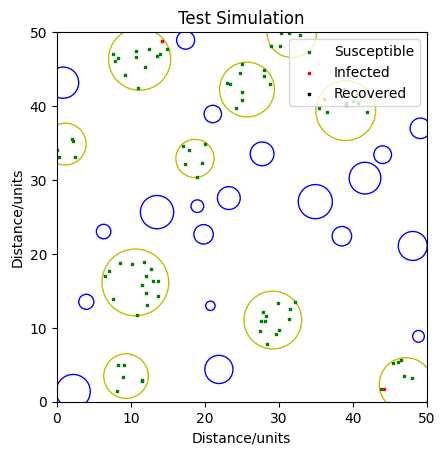

In [206]:
test_grid.plot()

Now we will run the simulation over 100 ticks.

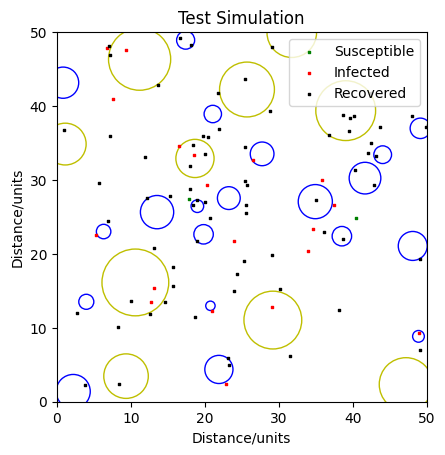

In [207]:
test_grid.animate(frames=100)

## Plotting the SIR Curves and Comparing with the Mathematical Model

Usually, the process of an infection is plotted on a stacked bar chart showing the percentage of susceptible, infected, and recovered (removed) each tick. Let's try doing that.

Since we have extracted Persons of different status (S, I, or R), all we have to do is count them and plot them on a graph. Conveniently, there is an animation addon from matplotlib that we can utilise to animate the progression of this curve over time.

In [208]:
# Create a Grid object
test_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=2, cbg_max_radius=5,
    poi_count=20, poi_min_radius=0.5, poi_max_radius=2.5,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='Test Simulation', seed=70000
    )

# Creating objects on the grid
test_grid.create_cbgs()
test_grid.create_pois()
test_grid.populate()
test_grid.patient_zero(5)

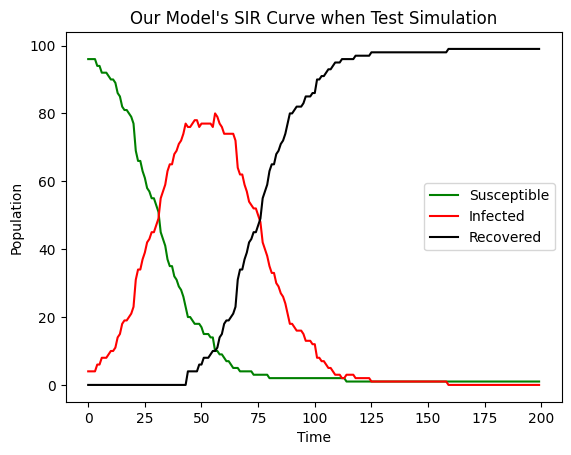

In [209]:
test_grid.plot_SIR(ticks=200)

Now, we will compare it to the mathematical SIR model.
The traditional model (with fixed population size) can be expressed as follows:

$$
\begin{cases}
\frac{dS}{dt} = -βIS \\
\frac{dI}{dt} = βIS - γI \\
\frac{dR}{dt} = γI
\end{cases}
$$

where S, I, and R represent the number of "Susceptible", "Infected", and "Recovered (Removed)" individuals in the population. $β$ is the transmission rate and $γ$ is the recovery rate.

Since we are assuming that the total population size remain constant, we can derive the following equation:

$$
\frac{dS}{dt} + \frac{dI}{dt} + \frac{dR}{dt} = 0
$$

With these equations, we will try to find and plot the analytic solutions of $S(t)$, $I(t)$, and $R(t)$.


In [210]:
def plot_SIR(
    I_0,    # Percentage of infected people at t=0
    beta,   # Infection rate
    gamma,  # Recovery rate
    time    # Simulation timespan
    ):

    # Create an array with the length of the simulation timespan (x values)
    t = np.linspace(0, time, time)

    # Create nparrays wwith the same dimensions as array "t" (y values)
    S = np.zeros_like(t)
    I = np.zeros_like(t)
    R = np.zeros_like(t)

    # Set starting conditions (y values at t=0)
    S[0] = 1 - I_0
    I[0] = I_0
    R[0] = 0

    # The system of differential equations can be expressed as follows:
    #   dS/dt = -beta * S * (I / N)
    #   dI/dt = beta * (S / N) * I - gamma * I
    #   dR/dt = gamma * I

    for i in range(time - 1):
        S[i+1] = S[i] - beta * S[i] * I[i]
        I[i+1] = I[i] + beta * S[i] * I[i] - gamma * I[i]
        R[i+1] = R[i] + gamma * I[i]

    plt.plot(t, S, 'g--', label='S')
    plt.plot(t, I, 'r--', label='I')
    plt.plot(t, R, 'k--', label='R')

    plt.legend()
    plt.xlabel('Time')
    plt.ylabel('Population')
    plt.title(f'SIR Curve ($I_0$={I_0}, $\\beta$={beta}, $\\gamma$={gamma})')
    plt.grid(True)

    plt.show()

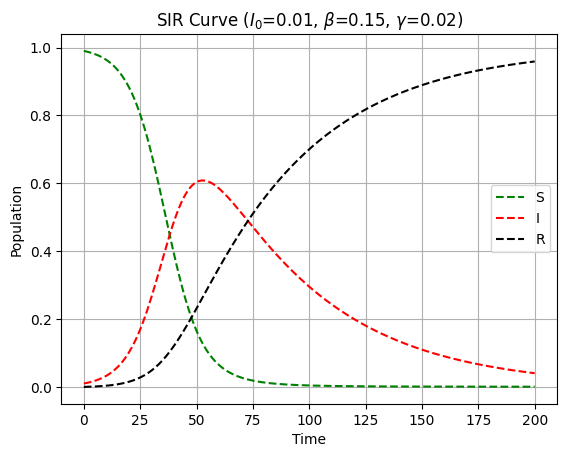

In [211]:
plot_SIR(I_0=0.01, beta=0.15, gamma=0.02, time=200)

# **Scenarios Simulation**

In this section, we will assess the predictive capabilities of our agent-based model (ABM) in comparison to the mathematical SIR model discussed previously. By creating various scenarios and adjusting both the ABM and SIR model to match these conditions, we can observe how closely the simulation results align with those of the mathematical model.

Following this comparison, we will analyze any subtle differences between the results of our ABM and the SIR model, seeking to explain why these discrepancies arise.

Our ultimate goal is to **revisit the mathematical SIR model, evaluate its efficacy** at predicting real-life disease spread, and **compare its abilities with our agent-based model**.

## Protocols

1. Generate Grid
```
# Create a Grid object
test_grid = grid = Grid(
    x_length=, y_length=, population_size=,
    cbg_count=, cbg_min_radius=, cbg_max_radius=,
    poi_count=, poi_min_radius=, poi_max_radius=,
    idle_time=, default_movement_speed=,
    infection_radius=, infection_chance=, recovery_time=, latency_time=,
    title=,
    seed=
)
# Initialise the grid
test_grid.create_cbgs()
test_grid.create_pois()
test_grid.populate()
test_grid.patient_zero()
```
2. Add in scenarios (if any)

3. Run the simulation and generate an SIR graph
```
test_grid.plot_SIR(ticks=)
```

4. Run mathematical model and generate an SIR graph
```
plot_SIR(I_0=, beta=, gamma=, time=)
```

## Scenarios

### 1. Mask-Wearing

Reduce the infection chance for a proportion of people (those who wear a mask) in the grid to be lower than the rest.

Parameters:
- grid: The Grid object containing the population to implement a mask policy.
- proportion: A float between 0 and 1 representing the proportion of people who wear masks.
- reduced_infection_chance: The new, lower infection chance value for the masked proportion.

In [212]:
def mask_wearing(grid, proportion, masked_infection_chance):

    # Ensure the proportion is between 0 and 1
    if not (0 <= proportion <= 1):
        raise ValueError("Proportion must be between 0 and 1.")

    # Determine the number of people who wear mask
    masked_population_size = int(proportion * len(grid.population))

    # Randomly select individuals to wear mask
    masked_population = np.random.choice(grid.population, masked_population_size, replace=False)

    # Modify infection chance for selected individuals
    for person in masked_population:
        person.infection_chance = masked_infection_chance

    print(f"Reduced infection chance for {masked_population_size} people who wear mask to {masked_infection_chance}.")

Comparing a mask-wearing population versus a population that does not wear masks.

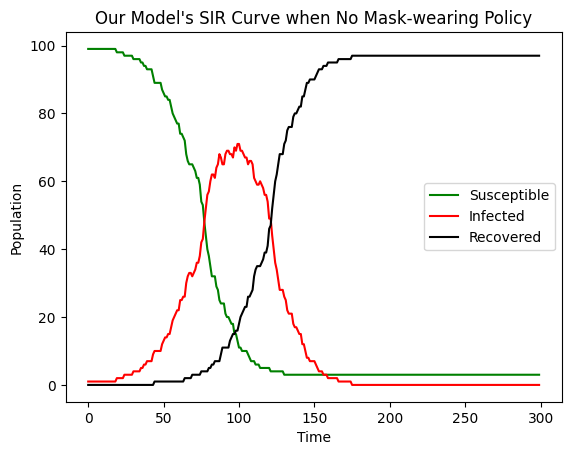

Reduced infection chance for 68 people who wear mask to 0.175.


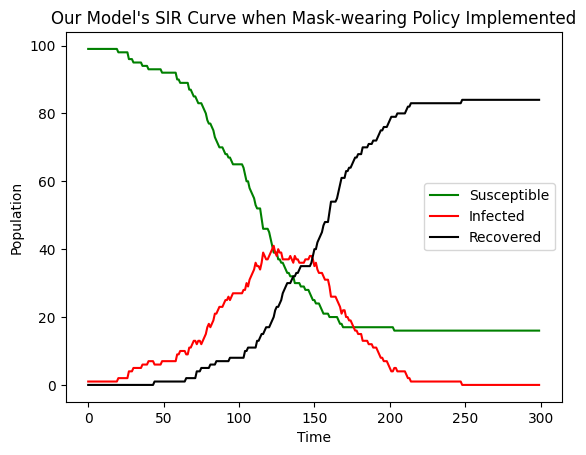

In [213]:
# Creating control grid (no mask-wearing)
control_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=2, cbg_max_radius=8,
    poi_count=20, poi_min_radius=1, poi_max_radius=5,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='No Mask-wearing Policy',
    seed=70000
)

control_grid.create_cbgs()
control_grid.create_pois()
control_grid.populate()
control_grid.patient_zero(1)
control_grid.plot_SIR(ticks=300)

# Creating masked grid (68% of population wear masks, wearing a mask reduces infection chances by 65%)
masked_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=2, cbg_max_radius=8,
    poi_count=20, poi_min_radius=1, poi_max_radius=5,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='Mask-wearing Policy Implemented',
    seed=70000
)

masked_grid.create_cbgs()
masked_grid.create_pois()
masked_grid.populate()
masked_grid.patient_zero(1)
mask_wearing(masked_grid, 0.68, (masked_grid.infection_chance * (1 - 0.65)))
masked_grid.plot_SIR(ticks=300)

Animating the Control Grid and Masked Grid.

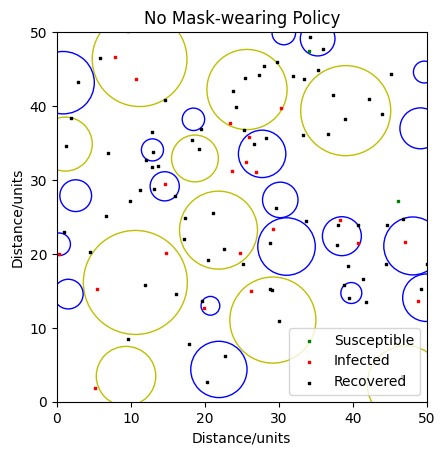

In [214]:
## Animating the Control
# Creating control grid (no mask-wearing)
control_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=2, cbg_max_radius=8,
    poi_count=20, poi_min_radius=1, poi_max_radius=5,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='No Mask-wearing Policy',
    seed=70000
)

control_grid.create_cbgs()
control_grid.create_pois()
control_grid.populate()
control_grid.patient_zero(5)
control_grid.animate(frames=100)

Reduced infection chance for 68 people who wear mask to 0.175.


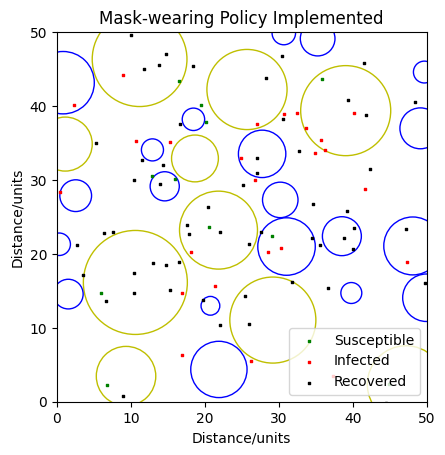

In [215]:
## Animating the Masked Grid
# Creating masked grid (68% of population wear masks, wearing a mask reduces infection chances by 65%)
masked_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=2, cbg_max_radius=8,
    poi_count=20, poi_min_radius=1, poi_max_radius=5,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='Mask-wearing Policy Implemented',
    seed=70000
)

masked_grid.create_cbgs()
masked_grid.create_pois()
masked_grid.populate()
masked_grid.patient_zero(5)
mask_wearing(masked_grid, 0.68, (masked_grid.infection_chance * (1 - 0.65)))
masked_grid.animate(frames=100)

Comparing with a traditional SIR model.

Since 68% of the population wears masks, and masks reduce infection chance by 65%, we can calculate an adjusted beta to reflect the lower infection probability. To calculate the Effective Transmission Rate `beta_effective` :

Let `beta` be the original transmission rate without mask-wearing.
Let `mask_wearing_proportion` be the proportion of the population wearing masks (68%, or 0.68). Let `mask_effectiveness` be the mask effectiveness (65%, or 0.65).

The effective transmission rate `beta_effective` , can be calculated as:

`
beta_effective = beta * (1 - mask_wearing_proportion * mask_effectiveness)
`

We can use this adjusted `beta_effective` in place of `beta` in the SIR model's differential equations to account for the reduced infection rate due to mask-wearing.

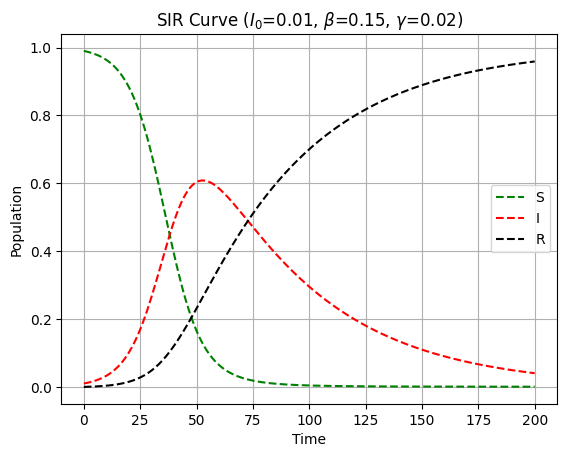

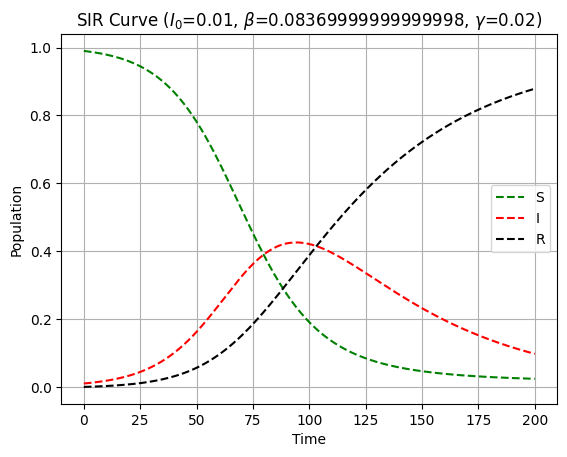

In [216]:
beta = 0.15
mask_wearing_proportion = 0.68
mask_effectiveness = 0.65
beta_effective = beta * (1 - mask_wearing_proportion * mask_effectiveness)

plot_SIR(I_0=0.01, beta=beta, gamma=0.02, time=200)
plot_SIR(I_0=0.01, beta=beta_effective, gamma=0.02, time=200)

### 2. Movement Restriction

In a lockdown, the movement of people are restricted. Hence, this can be achieved by increasing idle time at home, and restricting the movement of Person to POIs close to their homes.

The `lockdown()` function restricts movement for all people in the specified grid, applying lockdown across all CBGs. It only allows movement towards POIs that are within max_distance from each Person's home CBG and increases idle_time for people at home to simulate lockdown.

Parameters:
- grid: The Grid object containing all CBGs, POIs, and Persons.
- max_distance: The maximum allowed distance measured from each CBG center to POIs that a Person from that CBG is allowed to travel.
- idle_time_increase: The new increased idle_time for people to stay at home (CBG).

In [217]:
def lockdown(grid, max_distance, increased_idle_time):

    for person in grid.population:

        # Increase the person's idle_time to simulate lockdown at home
        grid.increased_idle_time = increased_idle_time

        # Get the home location (CBG) of the person
        home_cbg = person.home

        # Filter POIs that are within max_distance from the CBG's location
        close_pois = [
            poi for poi in grid.all_poi
            if np.linalg.norm(poi.location - home_cbg.location) <= max_distance
        ]

        # If there are any POIs within range, limit movement to only those
        if close_pois:
            person.allowed_pois = close_pois  # Set the allowed POIs for the person during lockdown

Comparing the spread when a lockdown is implemented versus when there is no lockdown implemented.

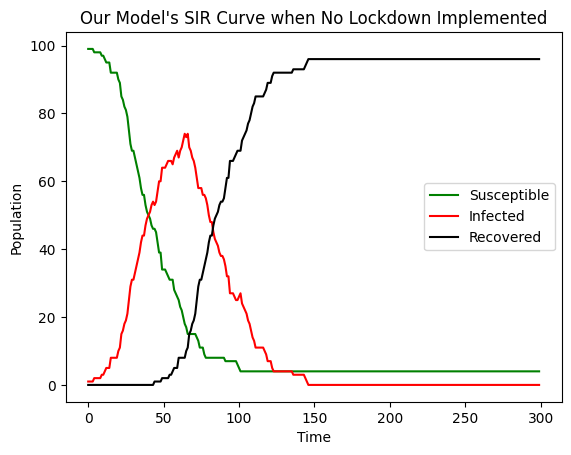

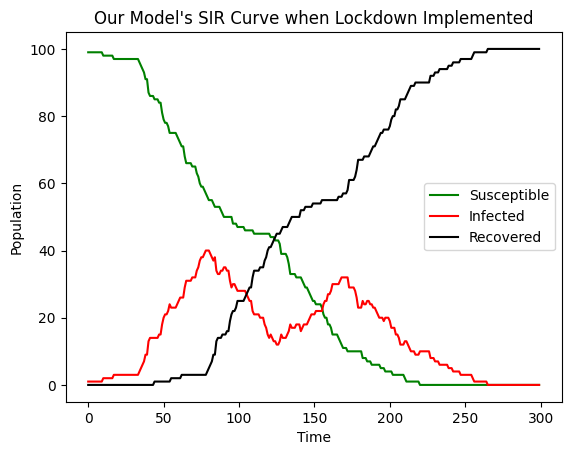

In [218]:
# Creating control grid (no lockdown)
control_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=1, cbg_max_radius=4,
    poi_count=20, poi_min_radius=0.5, poi_max_radius=3,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='No Lockdown Implemented',
    seed=70000
)

control_grid.create_cbgs()
control_grid.create_pois()
control_grid.populate()
control_grid.patient_zero(1)
control_grid.plot_SIR(ticks=300)

# Creating lockdown grid ()
ld_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=1, cbg_max_radius=4,
    poi_count=20, poi_min_radius=0.5, poi_max_radius=3,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='Lockdown Implemented',
    seed=70000
)

ld_grid.create_cbgs()
ld_grid.create_pois()
ld_grid.populate()
ld_grid.patient_zero(1)
lockdown(ld_grid, 15, 25)
ld_grid.plot_SIR(ticks=300)

Animating the Control Grid and Lockdown Grid.

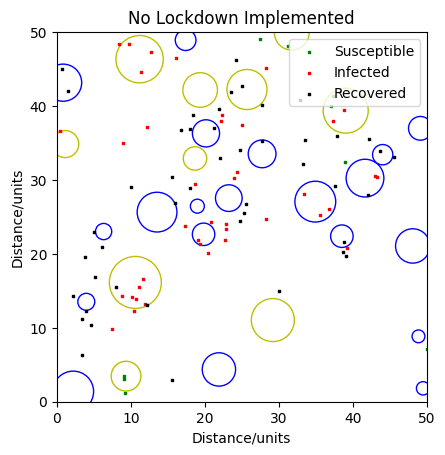

In [219]:
## Animating the Control
# Creating control grid (no lockdown)
control_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=1, cbg_max_radius=4,
    poi_count=20, poi_min_radius=0.5, poi_max_radius=3,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='No Lockdown Implemented',
    seed=70000
)

control_grid.create_cbgs()
control_grid.create_pois()
control_grid.populate()
control_grid.patient_zero(1)
control_grid.animate(frames=100)

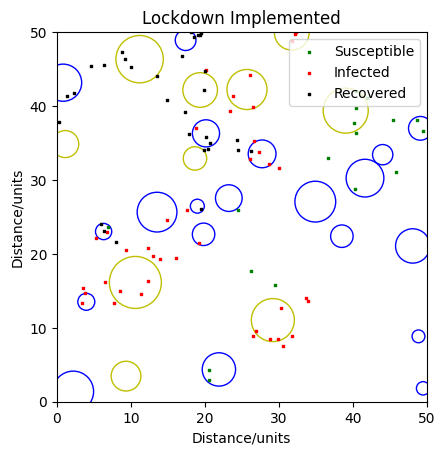

In [220]:
## Animating the Lockdown
# Creating lockdown grid ()
ld_grid = Grid(
    x_length=50, y_length=50, population_size=100,
    cbg_count=10, cbg_min_radius=1, cbg_max_radius=4,
    poi_count=20, poi_min_radius=0.5, poi_max_radius=3,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    title='Lockdown Implemented',
    seed=70000
)

ld_grid.create_cbgs()
ld_grid.create_pois()
ld_grid.populate()
ld_grid.patient_zero(1)
lockdown(ld_grid, 15, 25)
ld_grid.animate(frames=100)

Comparing with a traditional SIR model.

Lockdowns at the beginning of COVID-19 pandemic reduced the spread of infection by an estimated 56% (or 0.56).

Source: https://business.ucr.edu/news/2023/03/07/covid-lockdowns-reduced-disease-spread

Hence, we can calculate an adjusted beta to reflect the lower infection probability. To calculate the Effective Transmission Rate `beta_effective` :

Let `beta` be the original transmission rate without lockdowns. Let `infection_rate_reduce` be the reduction in transmission rate caused by lockdowns.
The effective transmission rate `beta_effective` , can be calculated as:

`
beta_effective = beta * (1 - infection_rate_reduce)
`

We can use this adjusted `beta_effective` in place of `beta` in the SIR model's differential equations to account for the reduced infection rate due to lockdowns.

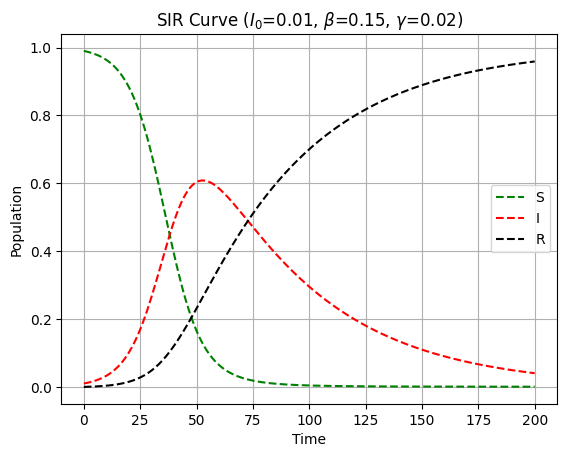

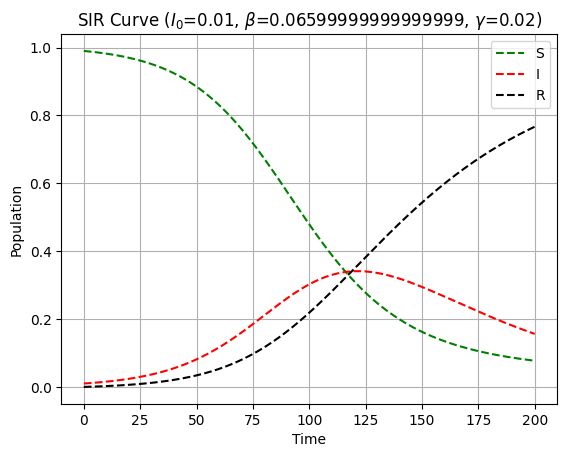

In [221]:
beta = 0.15
infection_rate_reduce = 0.56
beta_effective = beta * (1 - infection_rate_reduce)

plot_SIR(I_0=0.01, beta=beta, gamma=0.02, time=200)
plot_SIR(I_0=0.01, beta=beta_effective, gamma=0.02, time=200)

### 3. Simulation on an Island

Let's first try modelling Singapore (we'll convert the island into a rectangle for the sake of simplicity). The island is a semi-isolated system with a high population density and relies heavily on public transport, forming a population movement pattern, features that are similar to that of our model. Furthermore, the city is planned to form dedicated residential, education, and business zones, a setup that our model closely resembles.

Time to put people onto the island and run the simulation again. CBG and POI placements on this map are designed to mimic the urban planning of Singapore, and disease parameters are adjusted to simulate the omicron variant of SARS-CoV-2. (Average recovery time of around 2 weeks and average latency period of 3.4 days. Realistically, infection rate decreases exponentially with distance from around 60% at close distance to 1% at 1 metre away. Here we will simply assume that no one is practicing social distancing, and any contact within the distance of 1.5 units would have an average infection chance of 30%)

In [222]:
# Create a Grid object
island = Grid(
    x_length=40, y_length=25, population_size=200,
    default_movement_speed=0.1, idle_time=8,
    infection_chance=0.3, infection_radius=0.15,
    recovery_time=340, latency_time=80,
    title='Island Simulation',
    seed=0
    )

# Add CBGs and POIs to the grid
# Info format: ([x coordinate, y coordinate], radius)
CBG_info = [
    ([10.9, 10.6], 1.13), ([14.3, 10.8], 0.885), ([14.5, 14.2], 1.055),
    ([16.6, 13.3], 0.68), ([19.2, 18.5], 0.605), ([23.4, 17.4], 0.96),
    ([24.3, 11.6], 2.13), ([19.5, 7.8], 1.775), ([29.3, 11.9], 0.96),
    ([28.8, 14], 0.87), ([30.2, 15.7], 0.7), ([29.1, 6.1], 0.885),
    ([31.5, 6.7], 0.945), ([33.7, 7.2], 0.905), ([34.6, 10], 1.455)
    ]

POI_info =  [
    ([3.4, 4.0], 1.36), ([4.2, 9.7], 0.565), ([6.8, 7.4], 1.115),
    ([10.0, 3.0], 1.455), ([10, 7.8], 0.96), ([15.9, 9.1], 0.83),
    ([22.7, 6.4], 1.3), ([25.5, 6.1], 1.02), ([24.6, 3.3], 1.715),
    ([23.0, 0.8], 0.545), ([38.2, 10.9], 0.7), ([16.9, 18.7], 0.625)
    ]

island.all_cbg = [CBG(location=loc, radius=rad) for loc, rad in CBG_info]
island.all_poi = [POI(location=loc, radius=rad) for loc, rad in POI_info]

In [223]:
# Populating the grid
island.populate()
island.patient_zero(4)

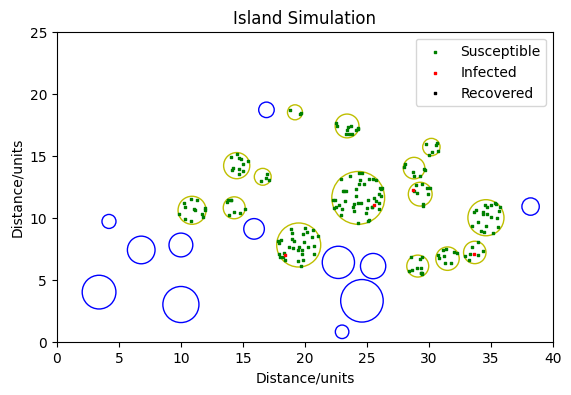

In [224]:
island.plot()

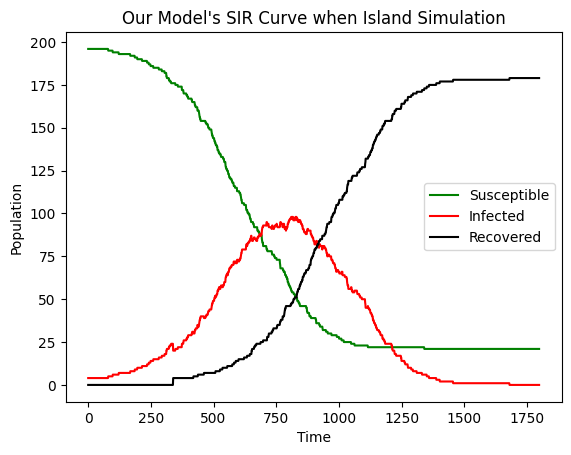

In [225]:
island.plot_SIR(ticks=1800)

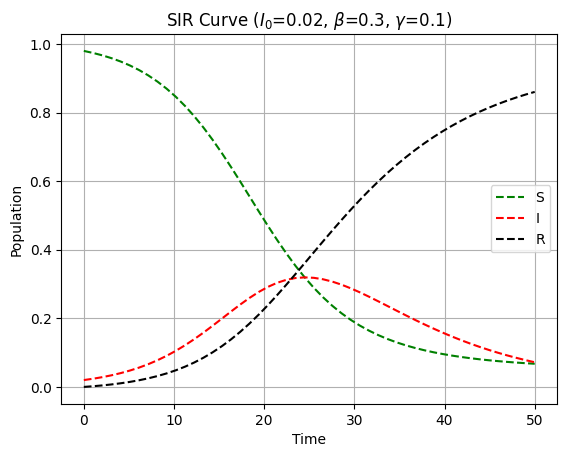

In [226]:
# Run mathematical model and generate a similar SIR graph
plot_SIR(I_0=0.02, beta=0.3, gamma=0.1, time=50)

# **Appendix**

Not necessary to run. It's just some additional information. Runtime: 4 hours 57 minutes.

### References


1. Chang, S., Pierson, E., Koh, P. W., Gerardin, J., Redbird, B., Grusky, D., & Leskovec, J. (2020). Mobility network models of COVID-19 explain inequities and inform reopening. Nature. https://doi.org/10.1038/s41586-020-2923-3

1. Department of Statistics, Singapore. (2024). Population and population structure. Population and Population Structure. https://www.singstat.gov.sg/find-data/search-by-theme/population/population-and-population-structure/latest-data

1. Fischer, C. B., Adrien, N., Silguero, J. J., Hopper, J. J., Chowdhury, A. I., & Werler, M. M. (2021). Mask adherence and rate of COVID-19 across the United States. PLOS ONE, 16(4), e0249891. https://doi.org/10.1371/journal.pone.0249891.

1. Gourieroux, C., & Lu, Y. (2020). SIR model with stochastic transmission. ArXiv:2011.07816v1.

1. Hunter, E., Mac Namee, B., & Kelleher, J. D. (2018). A comparison of agent-based models and equation-based models for infectious disease epidemiology. 26th AIAI Irish Conference on Artificial Intelligence and Cognitive Science, 2018. https://doi.org/10.21427/rtq2-hs52.

1. Keeling, M. J., & Rohani, P. (2008). Modeling infectious diseases in humans and animals. Princeton University Press.

1. Novakovic, A., & Marshall, A. H. (2022). The CP-ABM approach for modelling COVID-19 infection dynamics and quantifying the effects of non-pharmaceutical interventions. Pattern Recognition, 130, 108790. https://doi.org/10.1016/j.patcog.2022.108790

1. Perez, L., & Dragicevic, S. (2009). An agent-based approach for modeling dynamics of contagious disease spread. International Journal of Health Geographics, 8, 50. https://doi.org/10.1186/1476-072X-8-50.

1. Ponce Campuzano, J. C. (2020, March 27). SIR model. GeoGebra. https://www.geogebra.org/m/utbemrca

1. Svenson, O., Isohanni, F., Salo, I., & Lindholm, T. (2024). Airborne SARS-CoV-2 virus exposure, interpersonal distance, face mask and perceived risk of infection. Scientific Reports, 14(1). https://doi.org/10.1038/s41598-024-52711-2

1. UC Davis. (2020). Your mask cuts own risk by 65 percent. UC Davis. https://www.ucdavis.edu/coronavirus/news/your-mask-cuts-own-risk-65-percent.

1. University of California - Riverside. (2023, March 7). COVID lockdowns reduced disease spread. UCR News. https://business.ucr.edu/news/2023/03/07/covid-lockdowns-reduced-disease-spread

1. Wicki, S., Schwaab, J., Perhac, J., & Grêt-Regamey, A. (2021). Participatory multi-objective optimization for planning dense and green cities. Journal of Environmental Planning and Management, 64(14), 2532–2551. https://doi.org/10.1080/09640568.2021.1875999

1. Wu, Y., Kan, L., & Guo, Z. (2022). Incubation period of COVID-19 caused by unique SARS-CoV-2 strains - a systematic review and meta-analysis. Infectious Diseases. https://jamanetwork.com/journals/jamanetworkopen/fullarticle/2795489


### Runtime Testing to Simulate Larger Population Size using Our Model

We tried to increase population to 2000 people. Took 4h57m to run. No infection as Patient Zero recover before infecting others.

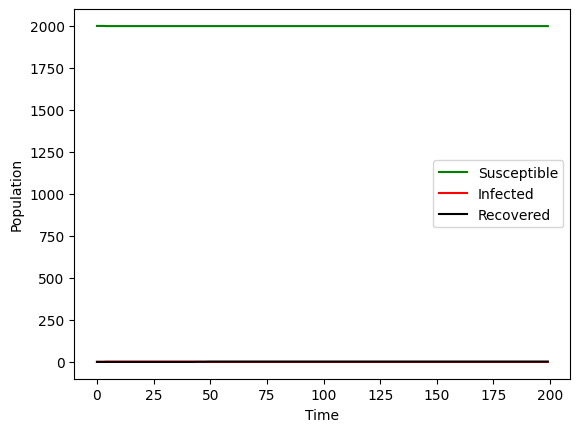

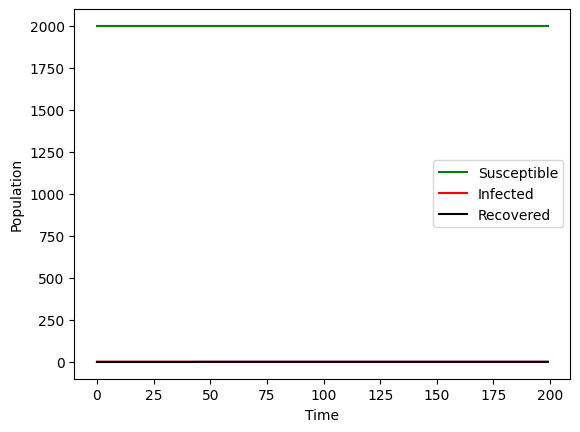

In [ ]:
# Creating control grid (no lockdown)
control_grid = Grid(
    x_length=500, y_length=500, population_size=2000,
    cbg_count=60, cbg_min_radius=10, cbg_max_radius=30,
    poi_count=110, poi_min_radius=5, poi_max_radius=15,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    seed=666
)

control_grid.create_cbgs()
control_grid.create_pois()
control_grid.populate()
control_grid.patient_zero(1)
control_grid.plot_SIR(ticks=200)

# Creating lockdown grid ()
ld_grid = Grid(
    x_length=500, y_length=500, population_size=2000,
    cbg_count=60, cbg_min_radius=10, cbg_max_radius=30,
    poi_count=110, poi_min_radius=5, poi_max_radius=15,
    idle_time=10, default_movement_speed=1,
    infection_radius=1.5, infection_chance=0.5, recovery_time=45, latency_time=5,
    seed=666
)

ld_grid.create_cbgs()
ld_grid.create_pois()
ld_grid.populate()
ld_grid.patient_zero(1)
lockdown(ld_grid, 50, 20)
ld_grid.plot_SIR(ticks=200)

### Code for SIR curve animation

In [ ]:
frames = 200
grid = test_grid

# Figure setup
fig, ax = plt.subplots()
ax.set_xlim(0, frames)
ax.set_ylim(0, grid.population_size)

# Plot the first frame
susceptible_plot, = ax.plot([], 'g-', label='Susceptible')
infected_plot, = ax.plot([], 'r-', label='Infected')
recovered_plot, = ax.plot([], 'k-', label='Recovered')
ax.legend()

# Create record lists for each state
susceptible_count = []
infected_count = []
recovered_count = []

# Frame number counter
frame_number = 0

# Frame Update Function
def update_frame(frame):
    global frame_number

    grid.movement_tick()
    grid.infection_tick()

    pop_dict = grid.population_dict()
    susceptible_count.append(len(pop_dict['susceptible']))
    infected_count.append(len(pop_dict['infected']))
    recovered_count.append(len(pop_dict['recovered']))

    x_labels = range(frame_number + 1)
    susceptible_plot.set_data(x_labels, susceptible_count)
    infected_plot.set_data(x_labels, infected_count)
    recovered_plot.set_data(x_labels, recovered_count)

    frame_number += 1
    if frame_number % 10 == 0:
        print(f"Frame {frame_number} completed.")

    return susceptible_plot, infected_plot, recovered_plot

ani = animation.FuncAnimation(
    fig=fig,
    func=update_frame,
    frames=frames,
    blit=True,
    interval=100
    )

HTML(ani.to_jshtml())
